In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
os.environ['HF_HUB_CACHE'] = '/share/shitao/downloaded_models'

from OmniGen import OmniGenPipeline

pipe = OmniGenPipeline.from_pretrained("Shitao/OmniGen-v1")

/opt/conda/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024-10-22 18:26:55.106937: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-22 18:26:55.109115: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-10-22 18:26:55.139637: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-22 18:26:55.139665: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cu

2024-10-22 18:26:55.970390: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Fetching 9 files: 100%|██████████| 9/9 [00:00<00:00, 113701.01it/s]


 42%|████▏     | 21/50 [00:18<00:23,  1.26it/s]

100%|██████████| 50/50 [00:42<00:00,  1.18it/s]


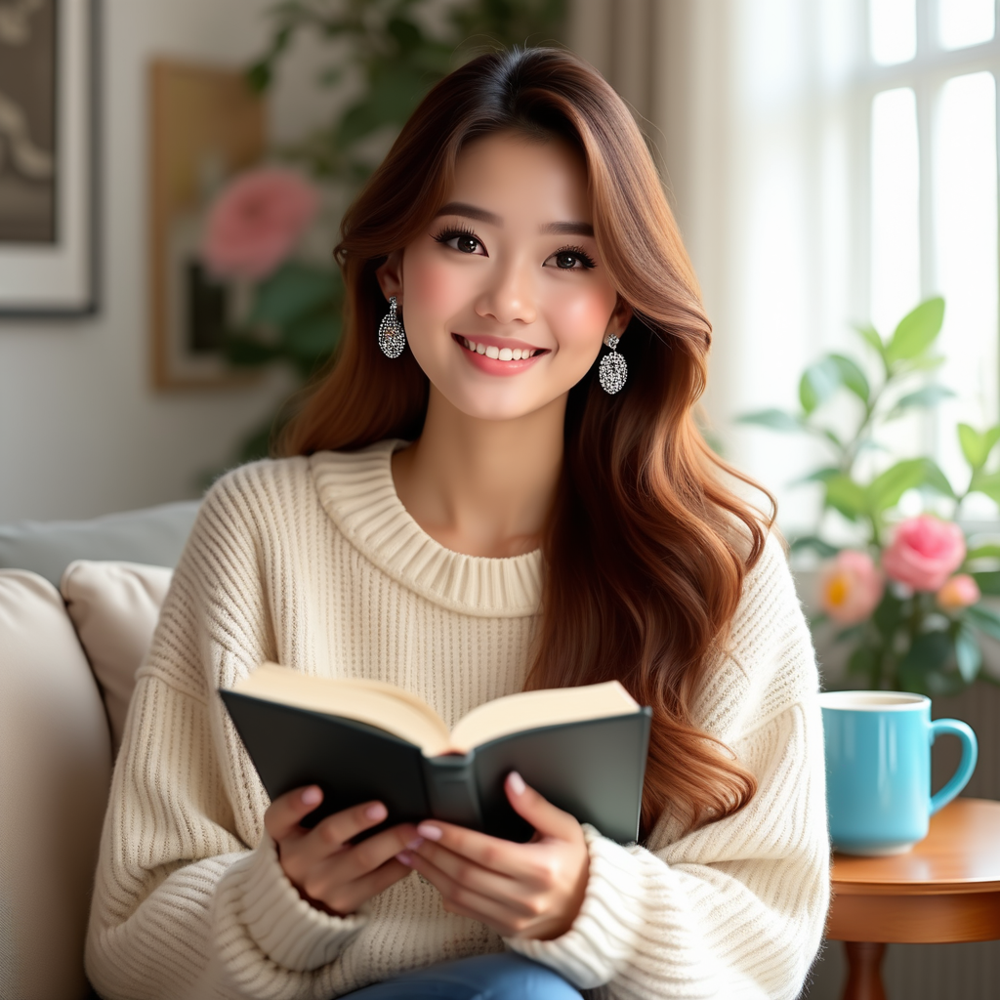

In [2]:
# Text to Image
prompt = "Realistic photo. A young woman sits on a sofa, holding a book and facing the camera. She wears delicate silver hoop earrings adorned with tiny, sparkling diamonds that catch the light, with her long chestnut hair cascading over her shoulders. Her eyes are focused and gentle, framed by long, dark lashes. She is dressed in a cozy cream sweater, which complements her warm, inviting smile. Behind her, there is a table with a cup of water in a sleek, minimalist blue mug. The background is a serene indoor setting with soft natural light filtering through a window, adorned with tasteful art and flowers, creating a cozy and peaceful ambiance. 4K, HD."
images = pipe(
    prompt=prompt, 
    height=1024, 
    width=1024, 
    guidance_scale=3,
    seed=111
    )
images[0].save("./imgs/demo_cases/t2i_woman_with_book.png")
images[0].show()

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [01:30<00:00,  1.82s/it]


input_image: 


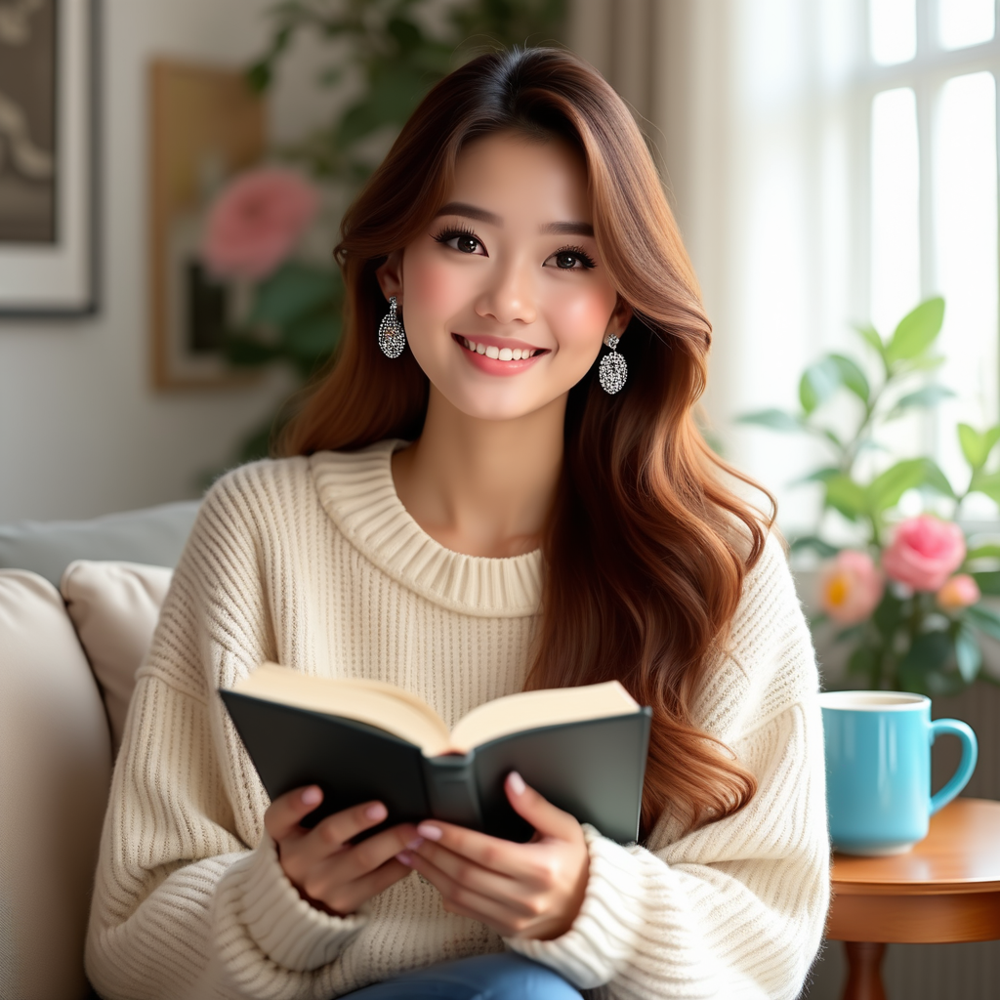

output: 


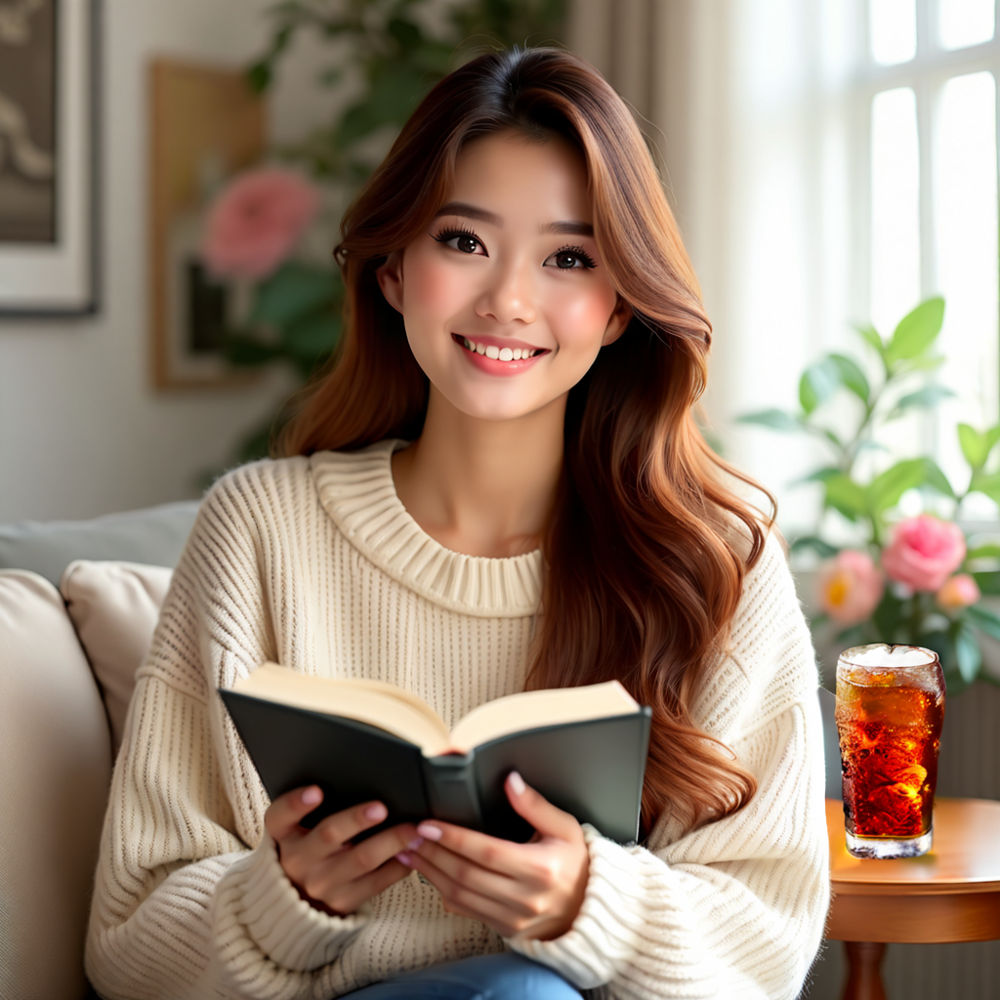

In [35]:
# Image Editing: Our model can perform multiple editing commands simultaneously.
from PIL import Image
prompt="<img><|image_1|><img>\n Remove the woman's earrings. Replace the mug with a clear glass filled with sparkling iced cola."
input_images=["./imgs/demo_cases/t2i_woman_with_book.png"]
images = pipe(
    prompt=prompt, 
    input_images=input_images, 
    height=1024, 
    width=1024,
    guidance_scale=2.5, 
    img_guidance_scale=1.6,
    seed=222) # NOTE: If you want to edit an image generated by OmniGen's text-to-image, you must use a seed that is different from the one used to generate the original image.
images[0].save("./imgs/demo_cases/edit.png")
print("input_image: ")
for img in input_images:
    Image.open(img).show()
print("output: ")
images[0].show()

100%|██████████| 50/50 [01:31<00:00,  1.82s/it]


input_image: 


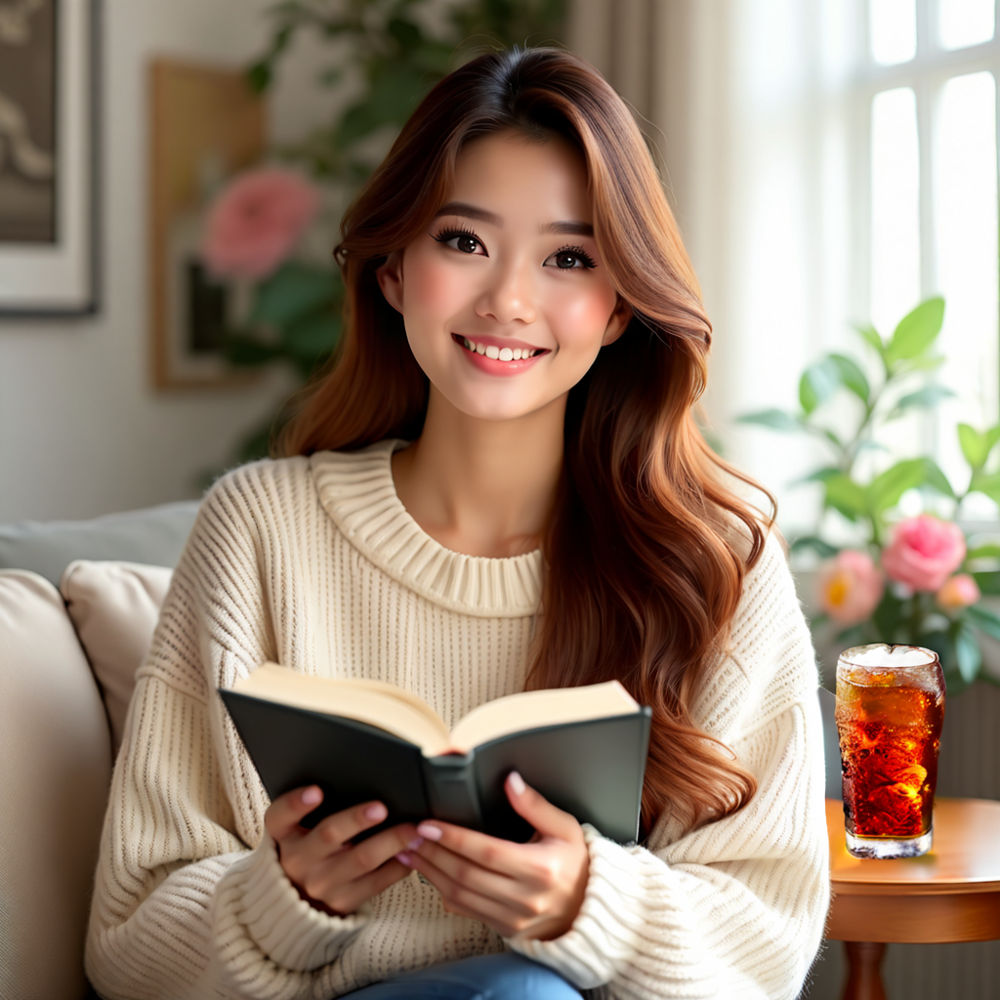

output:


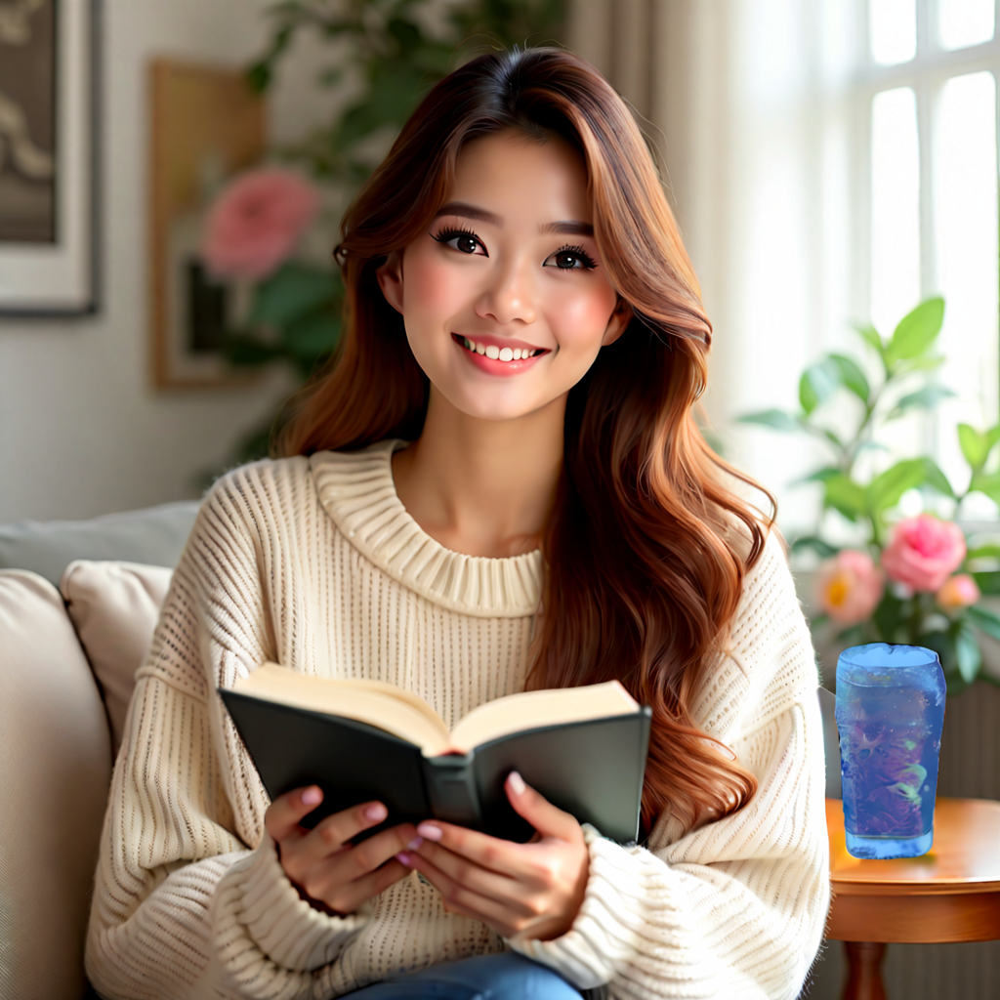

In [36]:
# Reasoning Ability: Our model demonstrates reasoning capabilities in response to images and commands.
from PIL import Image
prompt="If the woman is thirsty, what should she take? Find it in the image and highlight it in blue. <img><|image_1|><img>"
input_images=["./imgs/demo_cases/edit.png"]
images = pipe(
    prompt=prompt, 
    input_images=input_images, 
    height=1024, 
    width=1024,
    guidance_scale=2, 
    img_guidance_scale=1.6)
images[0].save("./imgs/demo_cases/reasoning.png")
print("input_image: ")
for img in input_images:
    Image.open(img).show()
print("output:")
images[0].show()

  2%|▏         | 1/50 [00:03<02:51,  3.49s/it]

100%|██████████| 50/50 [01:30<00:00,  1.82s/it]


input_image: 


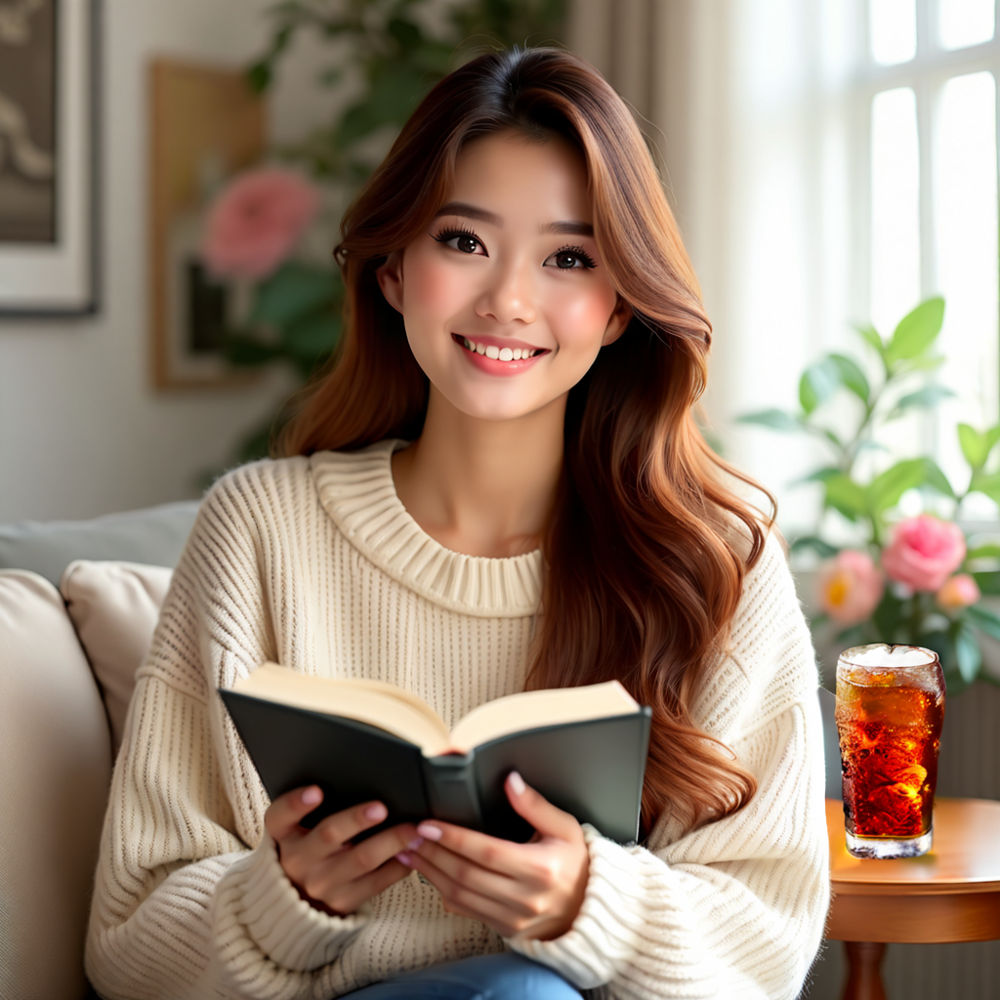

output:


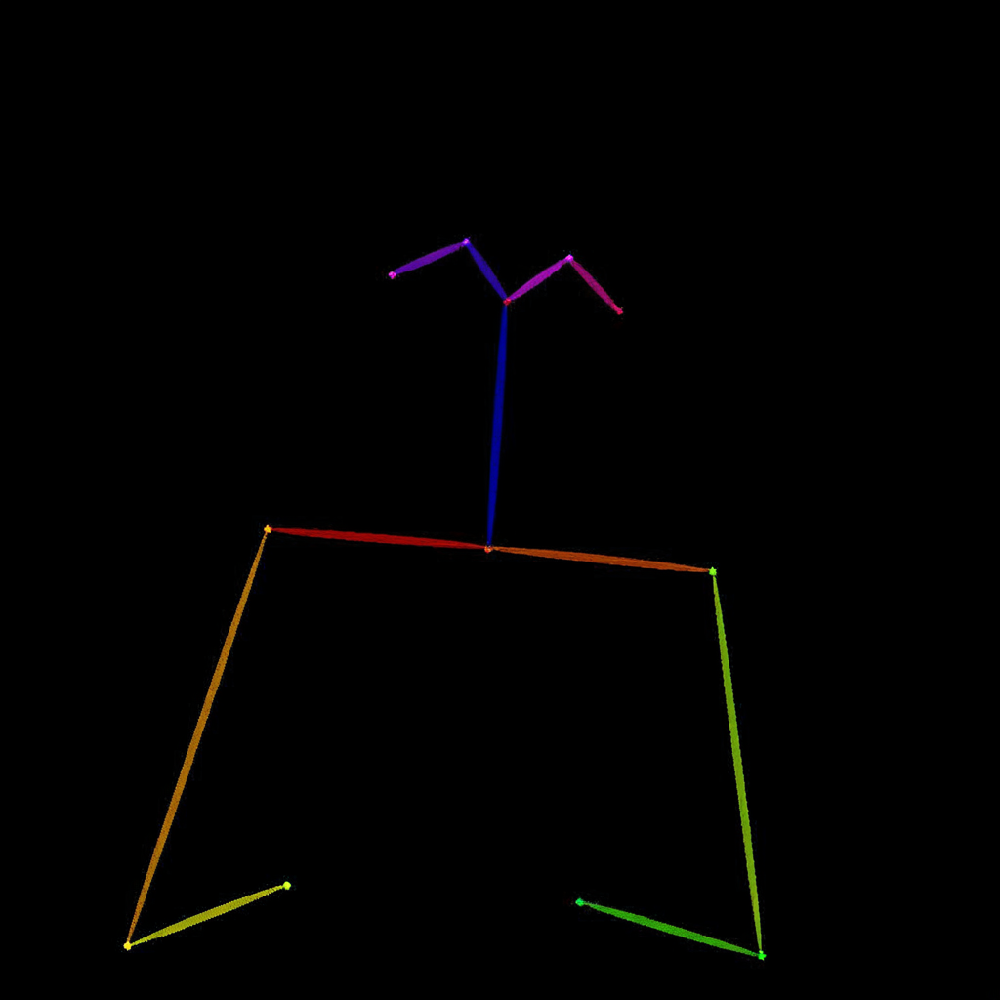

In [4]:
# Human Skeleton Detection: Our model also possesses high-level CV task capabilities, enabling accurate human skeleton recognition.
from PIL import Image
prompt="Detect the skeleton of human in this image: <img><|image_1|><img>"
input_images=["./imgs/demo_cases/edit.png"]
images = pipe(
    prompt=prompt, 
    input_images=input_images, 
    height=1024, 
    width=1024,
    guidance_scale=2, 
    img_guidance_scale=1.6,
    seed=333)
images[0].save("./imgs/demo_cases/skeletal.png")
print("input_image: ")
for img in input_images:
    Image.open(img).show()
print("output:")
images[0].show()

  6%|▌         | 3/50 [00:07<01:42,  2.18s/it]

100%|██████████| 50/50 [01:31<00:00,  1.83s/it]


input_image: 


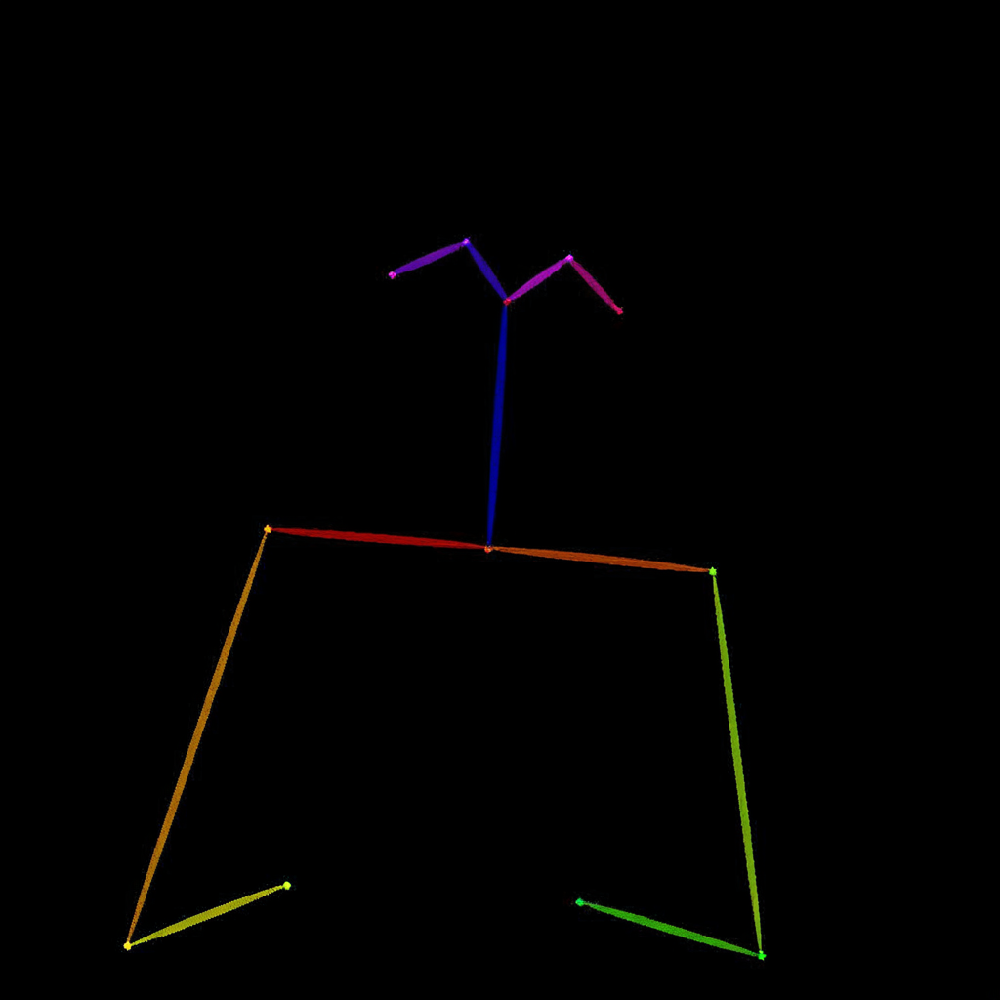

output:


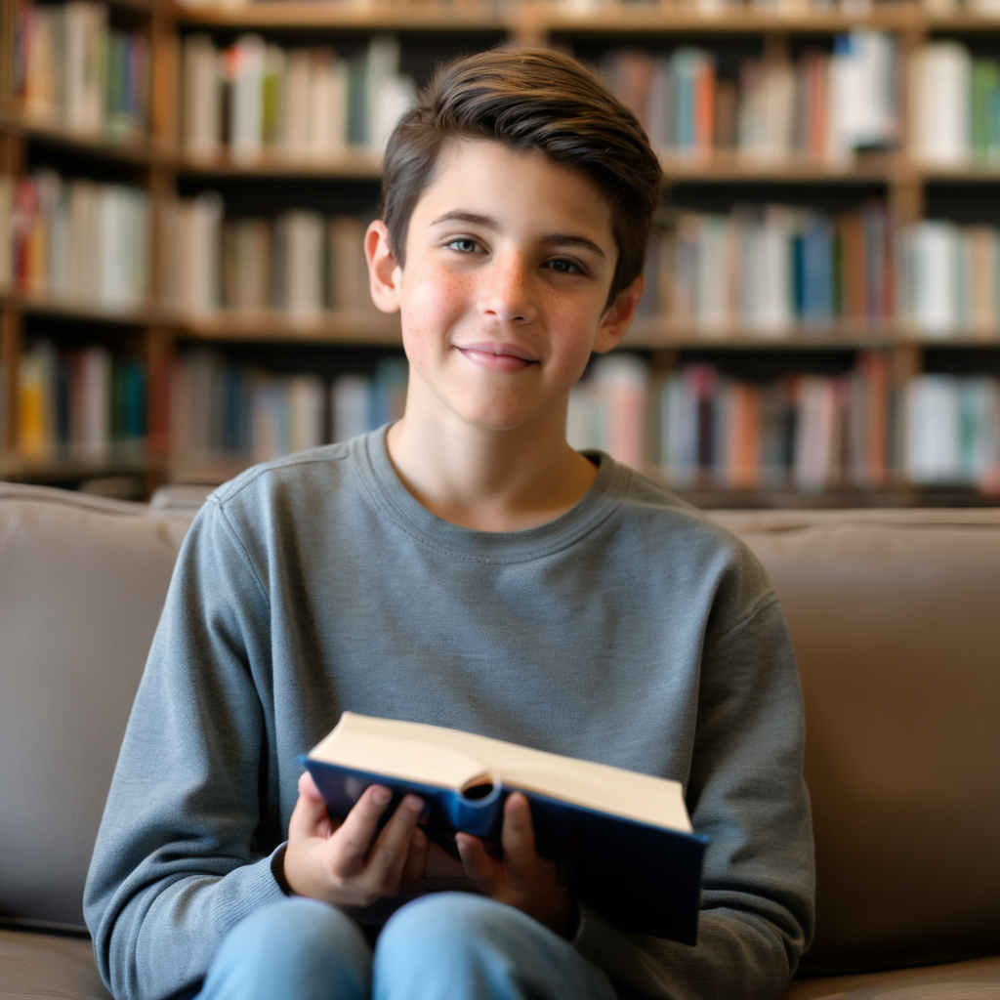

In [6]:
# Conditional Generation: Our model is capable of visual condition image generation.
from PIL import Image
prompt="Generate a new photo using the following picture and text as conditions: <img><|image_1|><img>\n A young boy is sitting on a sofa in the library, holding a book. His hair is neatly combed, and a faint smile plays on his lips, with a few freckles scattered across his cheeks. The library is quiet, with rows of shelves filled with books stretching out behind him."
input_images=["./imgs/demo_cases/skeletal.png"]
images = pipe(
    prompt=prompt, 
    input_images=input_images, 
    height=1024, 
    width=1024,
    guidance_scale=2, 
    img_guidance_scale=1.6,
    seed=321)
images[0].save("./imgs/demo_cases/skeletal2img.png")
print("input_image: ")
for img in input_images:
    Image.open(img).show()
print("output:")
images[0].show()

100%|██████████| 50/50 [01:31<00:00,  1.82s/it]


input_image: 


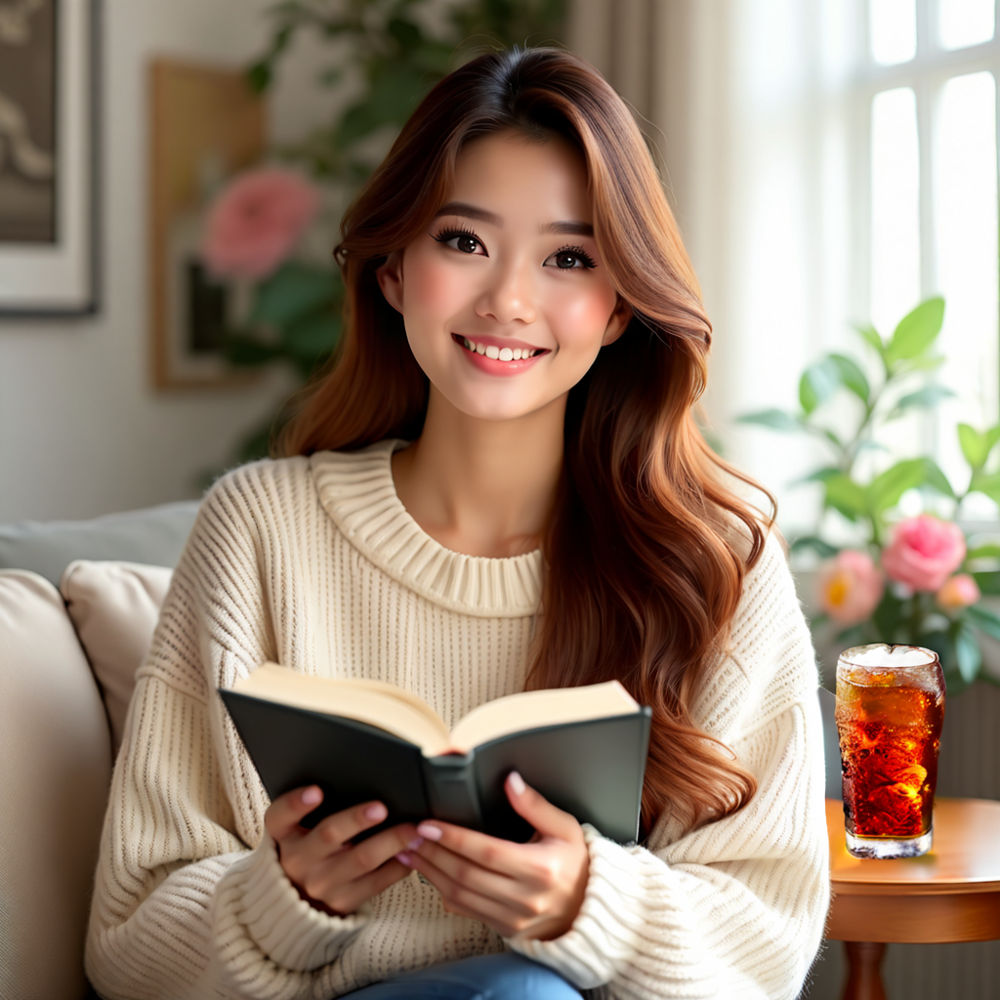

output:


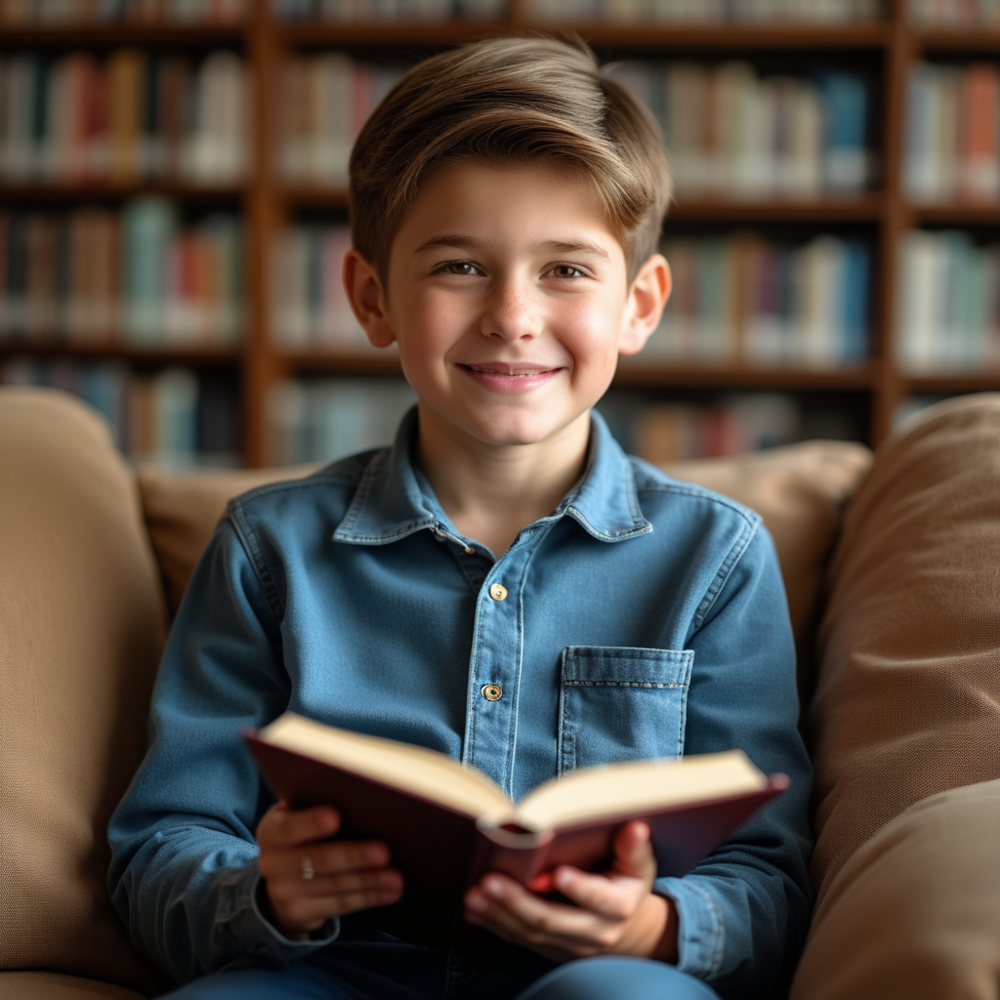

In [7]:
# Our model can perform complex visual condition image generation, directly generating another person's pose from an image end-to-end without skeleton recognition.

from PIL import Image
prompt="Following the pose of this image <img><|image_1|><img>, generate a new photo: A young boy is sitting on a sofa in the library, holding a book. His hair is neatly combed, and a faint smile plays on his lips, with a few freckles scattered across his cheeks. The library is quiet, with rows of shelves filled with books stretching out behind him."
input_images=["./imgs/demo_cases/edit.png"]
images = pipe(
    prompt=prompt, 
    input_images=input_images, 
    height=1024, 
    width=1024,
    guidance_scale=2, 
    img_guidance_scale=1.6,
    seed=123)
images[0].save("./imgs/demo_cases/same_pose.png")
print("input_image: ")
for img in input_images:
    Image.open(img).show()
print("output:")
images[0].show()

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [03:31<00:00,  4.22s/it]


input_image: 


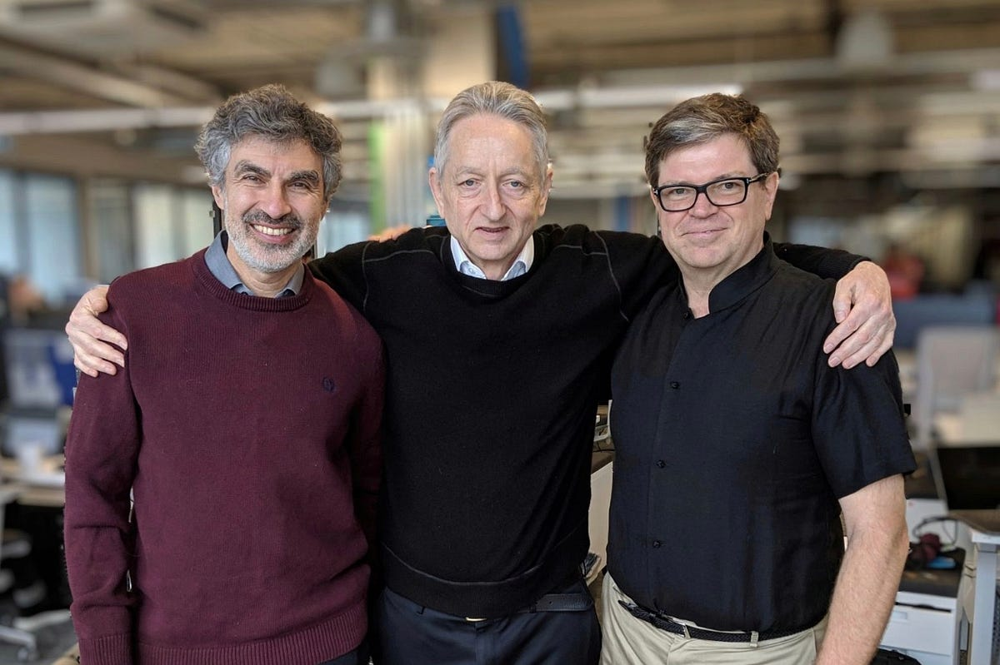

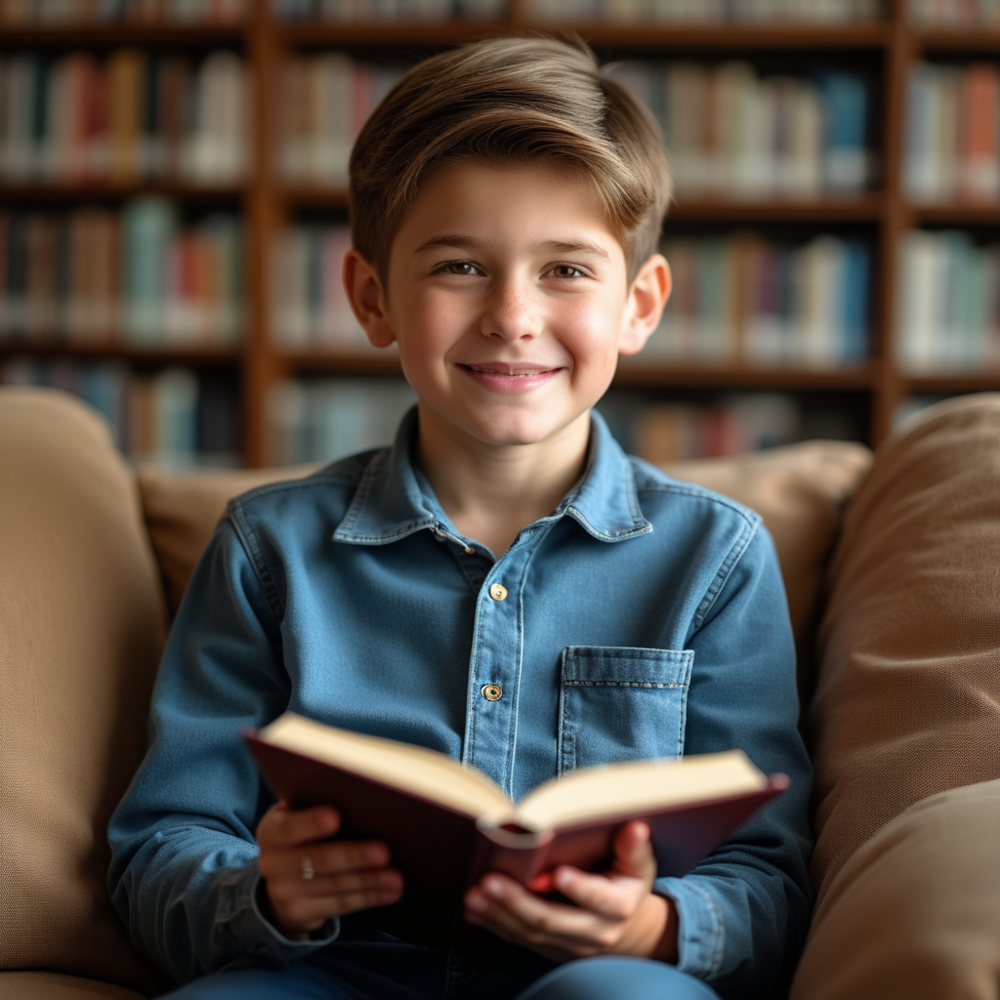

output:


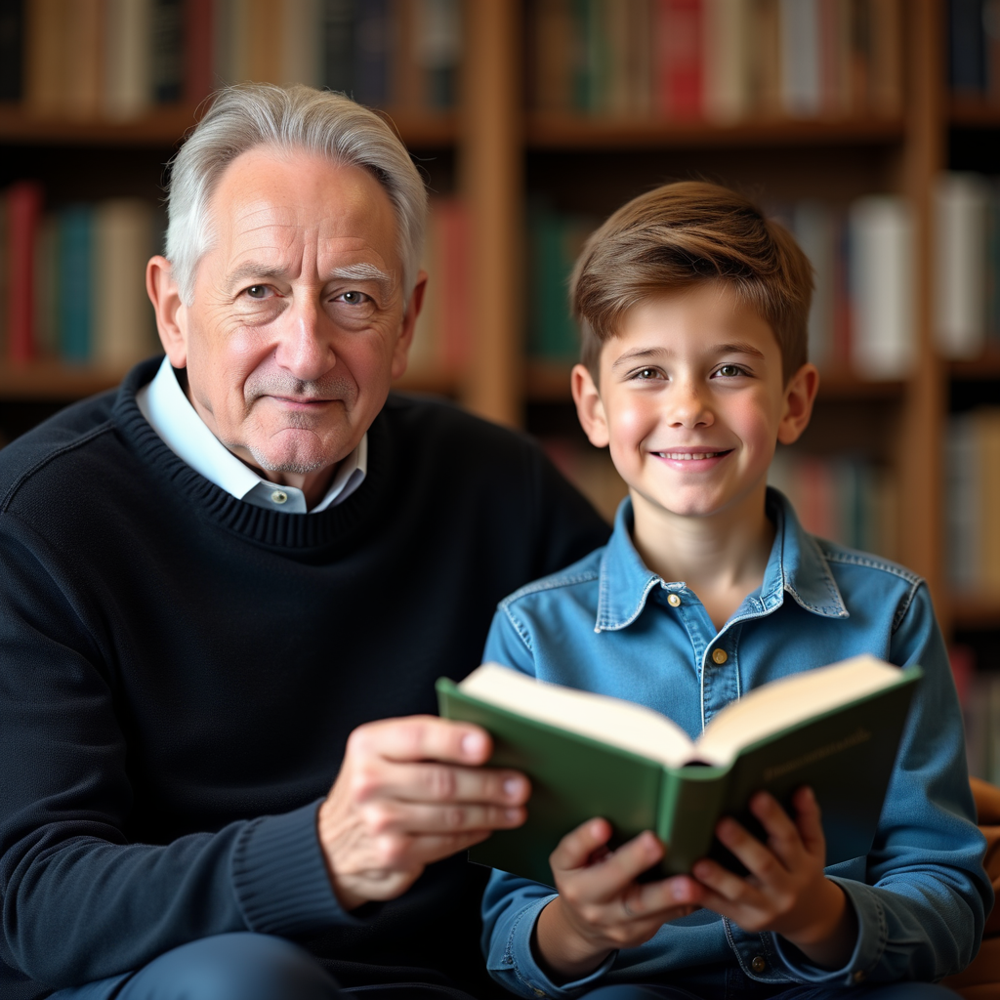

In [3]:
# Subject-Driven Ability: Our model can identify the described subject in multi-person images and generate group images of individuals from multiple sources. This end-to-end process requires no additional recognition or segmentation, highlighting OmniGen's flexibility and versatility.
from PIL import Image
prompt="A professor and a boy are reading books together. The professor is the middle man in <img><|image_1|></img>. The boy is the boy holding a book in <img><|image_2|></img>."
input_images=["./imgs/demo_cases/AI_Pioneers.jpg", "./imgs/demo_cases/same_pose.png"]
images = pipe(
    prompt=prompt, 
    input_images=input_images, 
    height=1024, 
    width=1024,
    guidance_scale=2.5, 
    img_guidance_scale=1.6,
    separate_cfg_infer=True,
    seed=0)
images[0].save("./imgs/demo_cases/entity.png")
print("input_image: ")
for img in input_images:
    Image.open(img).show()
print("output:")
images[0].show()